# What drives the price of a car?

![](images/kurt.jpeg)

**OVERVIEW**

In this application, you will explore a dataset from kaggle. The original dataset contained information on 3 million used cars. The provided dataset contains information on 426K cars to ensure speed of processing.  Your goal is to understand what factors make a car more or less expensive.  As a result of your analysis, you should provide clear recommendations to your client -- a used car dealership -- as to what consumers value in a used car.

### CRISP-DM Framework

<center>
    <img src = images/crisp.png width = 50%/>
</center>


To frame the task, throughout our practical applications we will refer back to a standard process in industry for data projects called CRISP-DM.  This process provides a framework for working through a data problem.  Your first step in this application will be to read through a brief overview of CRISP-DM [here](https://mo-pcco.s3.us-east-1.amazonaws.com/BH-PCMLAI/module_11/readings_starter.zip).  After reading the overview, answer the questions below.

### Business Understanding

From a business perspective, we are tasked with identifying key drivers for used car prices.  In the CRISP-DM overview, we are asked to convert this business framing to a data problem definition.  Using a few sentences, reframe the task as a data task with the appropriate technical vocabulary. 

In [188]:
## Data problem Definition

In [189]:
import pandas as pd
import numpy as np
# For plotting
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from matplotlib import rcParams


In [190]:
# Load the vehicles.csv file
vehicles = pd.read_csv('s3://ml-ai-bucket/vehicles.csv')
vehicles.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 426880 entries, 0 to 426879
Data columns (total 18 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   id            426880 non-null  int64  
 1   region        426880 non-null  object 
 2   price         426880 non-null  int64  
 3   year          425675 non-null  float64
 4   manufacturer  409234 non-null  object 
 5   model         421603 non-null  object 
 6   condition     252776 non-null  object 
 7   cylinders     249202 non-null  object 
 8   fuel          423867 non-null  object 
 9   odometer      422480 non-null  float64
 10  title_status  418638 non-null  object 
 11  transmission  424324 non-null  object 
 12  VIN           265838 non-null  object 
 13  drive         296313 non-null  object 
 14  size          120519 non-null  object 
 15  type          334022 non-null  object 
 16  paint_color   296677 non-null  object 
 17  state         426880 non-null  object 
dtypes: f

In [191]:
vehicles.sample(10)

,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,VIN,drive,size,type,paint_color,state
117917,7314819998,tampa bay area,1,2017.0,NaN,Maserati Ghibli,excellent,6 cylinders,gas,31101.0,clean,other,ZAM57RTS3H1262468,4wd,compact,sedan,white,fl
233611,7311165661,charlotte,14500,1984.0,ram,NaN,NaN,NaN,gas,90174.0,clean,automatic,NaN,NaN,NaN,NaN,NaN,nc
72303,7305606523,boulder,29590,2018.0,mercedes-benz,glc 300 sport,good,NaN,other,25067.0,clean,automatic,WDC0G4JB8JV031790,rwd,NaN,SUV,white,co
380748,7314976722,san antonio,37995,2017.0,ford,f-150,NaN,6 cylinders,gas,60525.0,clean,automatic,1FTEW1EG0HKD74351,4wd,NaN,pickup,black,tx
195167,7305686014,battle creek,6175,2010.0,subaru,forester,NaN,NaN,gas,174357.0,clean,automatic,NaN,NaN,NaN,NaN,NaN,mi
124650,7316808280,brunswick,33990,2020.0,ford,ranger supercrew xl pickup,good,NaN,other,1193.0,clean,other,1FTER4EH5LLA19535,NaN,NaN,pickup,NaN,ga
153716,7315378273,lafayette / west lafayette,3995,2003.0,NaN,OLDS BRAVADA,NaN,NaN,gas,178000.0,clean,automatic,NaN,NaN,NaN,NaN,NaN,in
119411,7315913684,treasure coast,3995,1997.0,volkswagen,cabriolet,excellent,4 cylinders,gas,125000.0,clean,manual,NaN,fwd,NaN,convertible,green,fl
180671,7316675665,annapolis,9900,1984.0,alfa-romeo,romeo spider veloce,excellent,4 cylinders,gas,85000.0,clean,manual,NaN,rwd,NaN,convertible,black,md
216523,7315042529,minneapolis / st paul,3500,2008.0,toyota,sienna cx,good,6 cylinders,gas,182772.0,clean,automatic,NaN,NaN,NaN,NaN,NaN,mn


In [192]:
vehicles.describe()

,id,price,year,odometer
count,4.268800e+05,4.268800e+05,425675.000000,4.224800e+05
mean,7.311487e+09,7.519903e+04,2011.235191,9.804333e+04
std,4.473170e+06,1.218228e+07,9.452120,2.138815e+05
min,7.207408e+09,0.000000e+00,1900.000000,0.000000e+00
25%,7.308143e+09,5.900000e+03,2008.000000,3.770400e+04
50%,7.312621e+09,1.395000e+04,2013.000000,8.554800e+04
75%,7.315254e+09,2.648575e+04,2017.000000,1.335425e+05
max,7.317101e+09,3.736929e+09,2022.000000,1.000000e+07


### Data Understanding

After considering the business understanding, we want to get familiar with our data.  Write down some steps that you would take to get to know the dataset and identify any quality issues within.  Take time to get to know the dataset and explore what information it contains and how this could be used to inform your business understanding.

In [193]:
vehicles.isnull().sum()

id                   0
region               0
price                0
year              1205
manufacturer     17646
model             5277
condition       174104
cylinders       177678
fuel              3013
odometer          4400
title_status      8242
transmission      2556
VIN             161042
drive           130567
size            306361
type             92858
paint_color     130203
state                0
dtype: int64

In [194]:
vehicles["price"].max()

3736928711

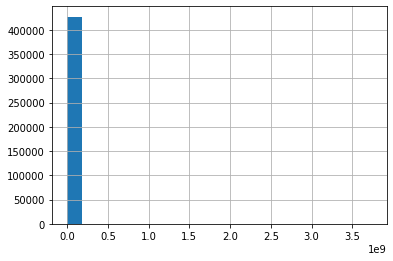

In [195]:
vehicles["price"].hist(bins=20)
plt.show()

<AxesSubplot:title={'center':'Average price by Manufacturer'}, xlabel='manufacturer'>

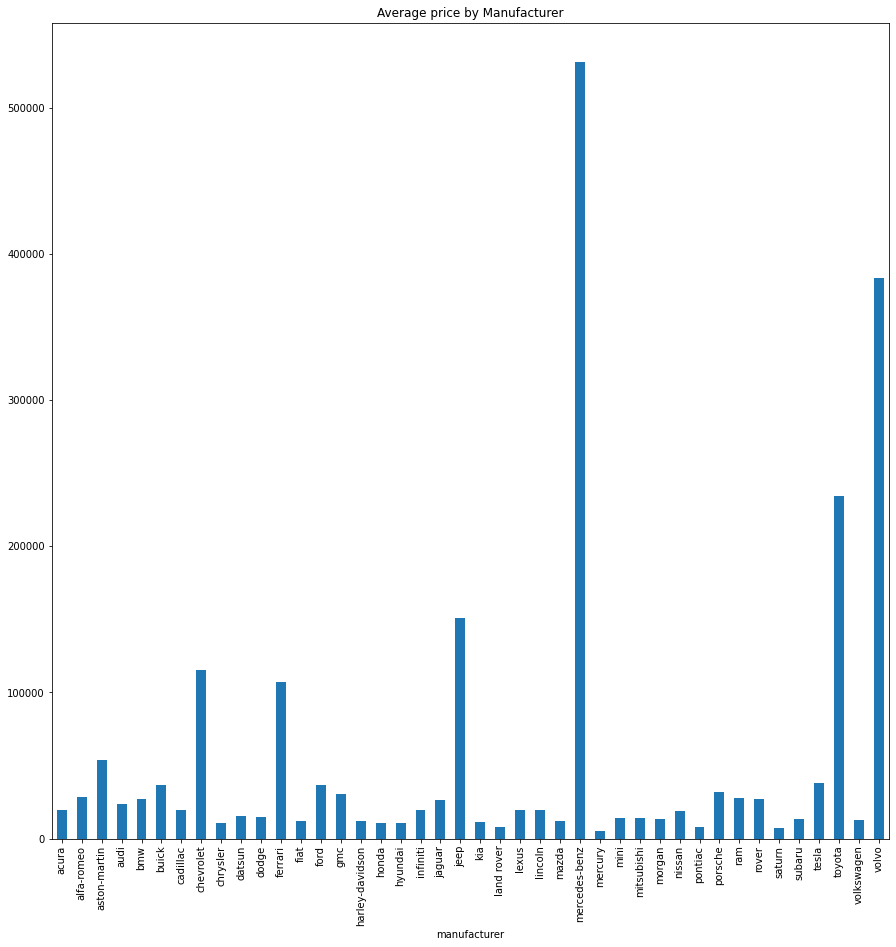

In [196]:
avg_price_by_manufacturer = vehicles.groupby("manufacturer")["price"].mean()
avg_price_by_manufacturer.plot(kind="bar", title="Average price by Manufacturer", figsize=(15,15))

<AxesSubplot:title={'center':'Average price by Cylinders'}, xlabel='cylinders'>

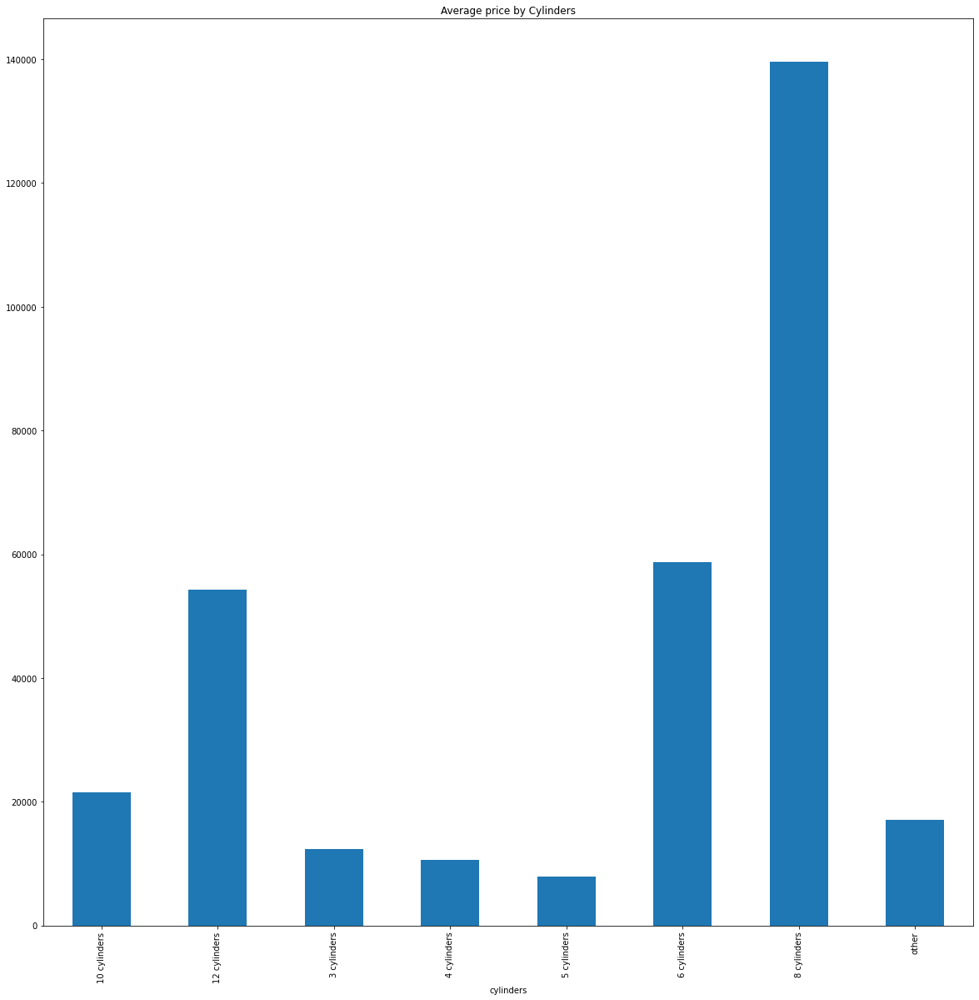

In [197]:
# Average price by Cylinders
avg_price_by_manufacturer = vehicles.groupby("cylinders")["price"].mean()
avg_price_by_manufacturer.plot(kind="bar", title="Average price by Cylinders", figsize=(20,20))

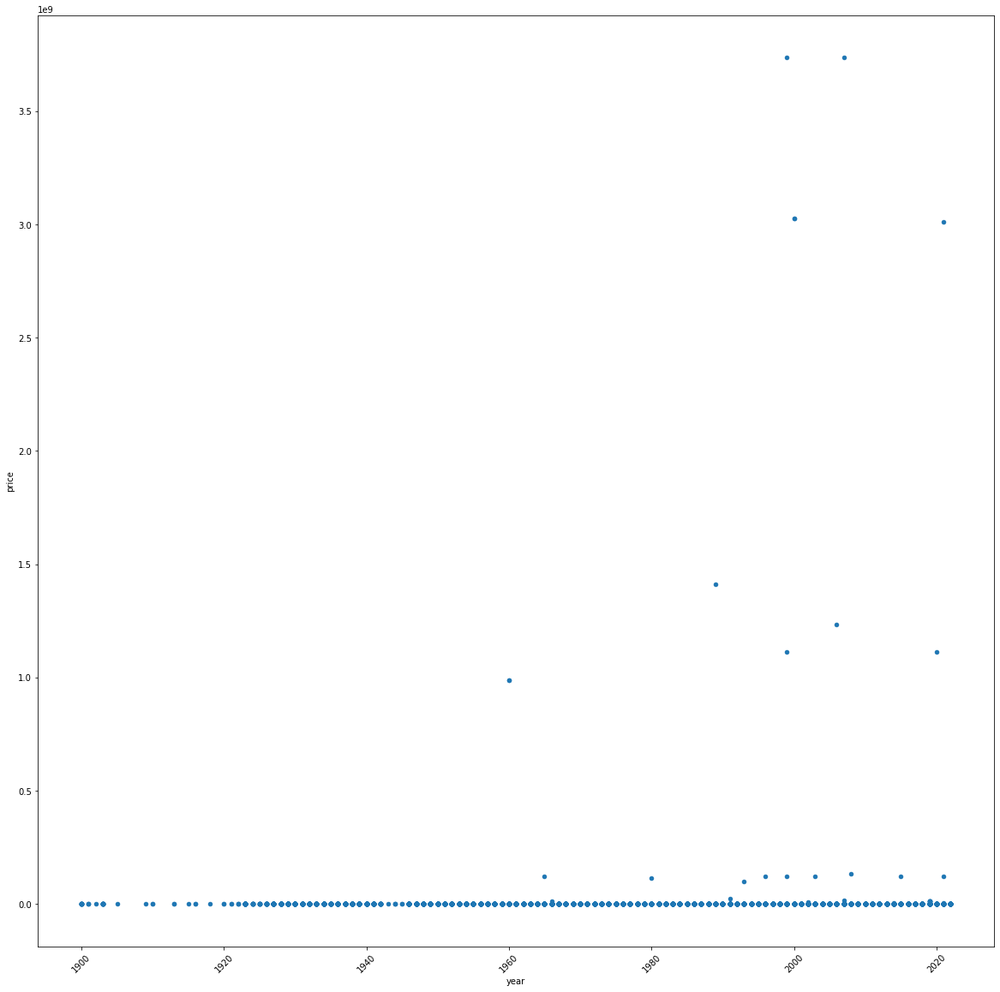

In [198]:
## Average price of the car year trends
avg_price_year = vehicles.groupby("year")["price"].mean()

vehicles.plot(x="year", y="price", kind="scatter", figsize=(20,20), rot=45)
plt.show()



### Data Preparation

After our initial exploration and fine tuning of the business understanding, it is time to construct our final dataset prior to modeling.  Here, we want to make sure to handle any integrity issues and cleaning, the engineering of new features, any transformations that we believe should happen (scaling, logarithms, normalization, etc.), and general preparation for modeling with `sklearn`. 

In [199]:
#checking null values
vehicles.isnull().sum()

id                   0
region               0
price                0
year              1205
manufacturer     17646
model             5277
condition       174104
cylinders       177678
fuel              3013
odometer          4400
title_status      8242
transmission      2556
VIN             161042
drive           130567
size            306361
type             92858
paint_color     130203
state                0
dtype: int64

In [200]:
# VIN number is not useful for price prediciton dropping it
vehicles = vehicles.drop(columns="VIN", axis=0)
vehicles.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 426880 entries, 0 to 426879
Data columns (total 17 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   id            426880 non-null  int64  
 1   region        426880 non-null  object 
 2   price         426880 non-null  int64  
 3   year          425675 non-null  float64
 4   manufacturer  409234 non-null  object 
 5   model         421603 non-null  object 
 6   condition     252776 non-null  object 
 7   cylinders     249202 non-null  object 
 8   fuel          423867 non-null  object 
 9   odometer      422480 non-null  float64
 10  title_status  418638 non-null  object 
 11  transmission  424324 non-null  object 
 12  drive         296313 non-null  object 
 13  size          120519 non-null  object 
 14  type          334022 non-null  object 
 15  paint_color   296677 non-null  object 
 16  state         426880 non-null  object 
dtypes: float64(2), int64(2), object(13)
memory usage

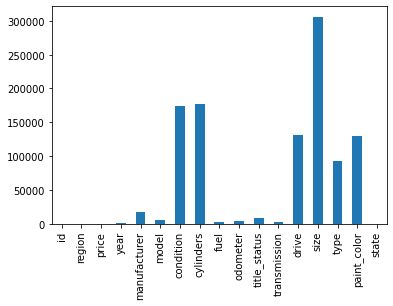

In [201]:
# Check missing values in the data
vehicles.isna().sum().plot(kind="bar")
plt.show()

In [202]:
#option 1 is removing the data - dropna() - it may not be ideal if we have a lot of data with that observations.For example size
#option 2 fillna - filling with 0, mean, or some other value
#option 3 fill with mean, mode extra

#Deleting records with null values less than 5000
vehicles.dropna(subset=['manufacturer', 'model', 'fuel', 'odometer', 'transmission','year'], inplace=True)


In [203]:
print(vehicles["condition"].unique())
print(vehicles["cylinders"].unique())
print(vehicles["title_status"].unique())
print(vehicles["drive"].unique())
print(vehicles["size"].unique())
print(vehicles["type"].unique())
print(vehicles["paint_color"].unique())

['good' 'excellent' 'fair' 'like new' 'new' nan 'salvage']
['8 cylinders' '6 cylinders' nan '4 cylinders' '5 cylinders'
 '10 cylinders' '3 cylinders' 'other' '12 cylinders']
['clean' 'rebuilt' 'lien' nan 'salvage' 'missing' 'parts only']
[nan 'rwd' '4wd' 'fwd']
[nan 'full-size' 'mid-size' 'compact' 'sub-compact']
['pickup' 'truck' 'other' nan 'coupe' 'SUV' 'hatchback' 'mini-van' 'sedan'
 'offroad' 'van' 'convertible' 'wagon' 'bus']
['white' 'blue' 'red' 'black' 'silver' 'grey' nan 'brown' 'yellow'
 'orange' 'green' 'custom' 'purple']


In [204]:
# Populating null values with default values
values = {"cylinders":"other", "condition":"fair", "title_status":"missing", "drive":"other", "size":"other","type":"other","paint_color":"not_specified"}
vehicles.fillna(value=values,inplace=True)


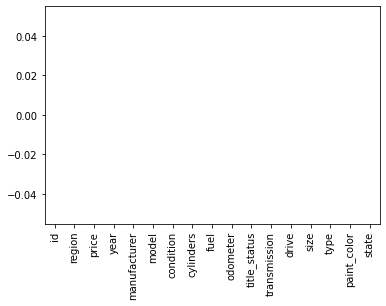

In [205]:
# Removed or filled with default values for all the null values.
vehicles.isna().sum().plot(kind="bar")
plt.show()

### Checking variance and removing outliers

In [206]:
## Checking the variances for the price, year, odometer
variances = vehicles[["price", "year", "odometer"]].var()
print(variances)

price       1.288459e+14
year        7.389155e+01
odometer    3.607707e+10
dtype: float64


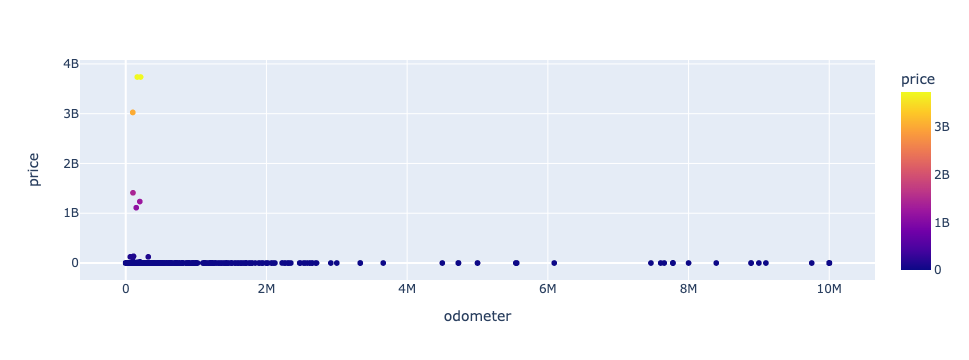

In [185]:
px.scatter(vehicles, x ="odometer", y="price", color="price")

51495
121469121.12344196


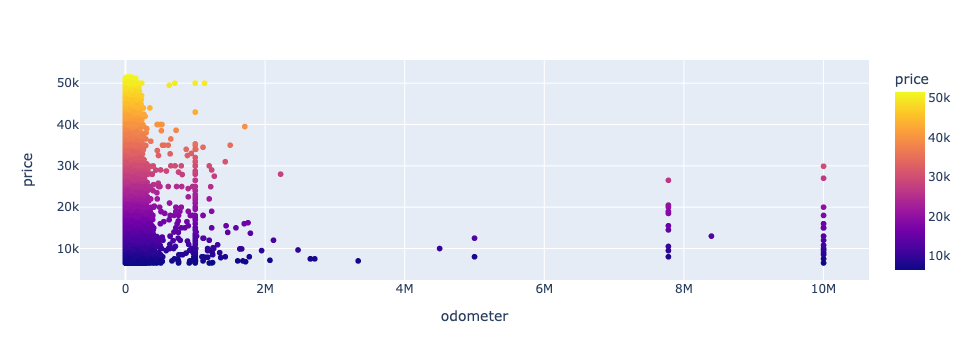

In [215]:
#Removing outliers
lower_ten_percent = vehicles["price"].quantile(.10)
upper_ninty_nice_percent = vehicles["price"].quantile(.99)
vehicles = vehicles.loc[(vehicles["price"] >= lower_ten_percent) & (vehicles["price"] <= upper_ninty_nice_percent)]
print(vehicles["price"].max())
print(vehicles["price"].var())
px.scatter(vehicles, x ="odometer", y="price", color="price")

### Modeling

With your (almost?) final dataset in hand, it is now time to build some models.  Here, you should build a number of different regression models with the price as the target.  In building your models, you should explore different parameters and be sure to cross-validate your findings.

### Evaluation

With some modeling accomplished, we aim to reflect on what we identify as a high quality model and what we are able to learn from this.  We should review our business objective and explore how well we can provide meaningful insight on drivers of used car prices.  Your goal now is to distill your findings and determine whether the earlier phases need revisitation and adjustment or if you have information of value to bring back to your client.

### Deployment

Now that we've settled on our models and findings, it is time to deliver the information to the client.  You should organize your work as a basic report that details your primary findings.  Keep in mind that your audience is a group of used car dealers interested in fine tuning their inventory.